# Data

The dataset given to us is as follows,

- __train_transaction.csv__ : The transaction dataset comprising the transaction details to be used for training the model.


- __train_identity.csv__ : The identity dataset comprising the additional details about the identity of the payer and the merchant among whom the transaction was performed, the details of which are present in the train_transaction.csv.


- __test_transaction.csv__ : The transaction dataset comprising the transaction information to test the performance of the trained model.


- __test_identity.csv__ : The identity dataset comprising the additional identity information about the transactions present in the test_transaction.


__Description of Transaction Dataset__

  - **TransactionID** - Id of the transaction and is the foreign key in the Identity Table.

  - **isFraud** - 0 or 1 signifying whether a transaction was fraudulent or not.

  - **TransactionDT** - timedelta from a given reference datetime (not an actual timestamp)

  - **TransactionAMT** - Transaction Payment Amount in USD.

  - **ProductCD** - Product Code.

  - **card1 - card6** - Payment Card information, such as card type, card category, issue bank, country, etc.

  - **addr** - Address

  - **dist** - Distance

  - **P_emaildomain** - Purchaser Email Domain.

  - **R_emaildomain** - Receiver Email Domain.

  - **C1-C14** - counting, such as how many addresses are found to be associated with the payment card, etc. The actual meaning is masked.

  - **D1-D15** - timedelta, such as days between previous transactions, etc.

  - **M1-M9** - match, such as names on card and address, etc.

  - **Vxxx** - Vesta engineered rich features, including ranking, counting, and other entity relations.

>_**Categorical Features**_ -

    - ProductCD
    - card1-card6
    - addr1, addr2
    - P_emaildomain
    - R_emaildomain
    - M1-M9



In [1]:
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns



In [9]:

train_transaction_df = pd.read_csv('./ieee-fraud-detection/train_transaction.csv')
train_identity_df = pd.read_csv('./ieee-fraud-detection/train_identity.csv')
train_df = train_transaction_df.merge(train_identity_df, on='TransactionID', how='left')

print(f"{train_transaction_df.shape = }, \n{train_identity_df.shape = }, \n{train_df.shape = }")


train_transaction_df.shape = (590540, 394), 
train_identity_df.shape = (144233, 41), 
train_df.shape = (590540, 434)


In [10]:
train = train_df.sample(frac=0.2, random_state=42)
print(f"{train.shape = }")

train.shape = (118108, 434)


In [11]:
columns = train.columns.values.tolist()


In [12]:
# Loading Test Dataset

test_transaction = pd.read_csv('./ieee-fraud-detection/test_transaction.csv')
test_identity = pd.read_csv('./ieee-fraud-detection/test_identity.csv')
print("Test Transaction Dataset Shape : ",test_transaction.shape)
print("Test Identity Dataset Shape : ",test_identity.shape)

Test Transaction Dataset Shape :  (506691, 393)
Test Identity Dataset Shape :  (141907, 41)


In [13]:
train_df = train_transaction_df.merge(train_identity_df, how='left', on='TransactionID')
del train_transaction_df, train_identity_df, test_transaction, test_identity
train_data = train_df


# Label Analysis

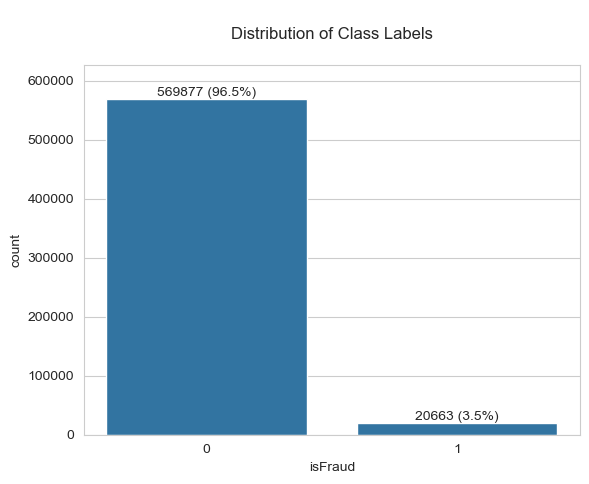

In [21]:
ax = sns.countplot(x='isFraud', data = train_data)

plt.title("\nDistribution of Class Labels\n")

plt.margins(0.05, 0.1)

for p in ax.patches:
  x=p.get_bbox().get_points()[:,0]
  y=p.get_bbox().get_points()[1,1]
  ax.annotate('{} ({:.1f}%)'.format(int(y),100.*y/len(train_data)), (x.mean(), y),
          ha='center', va='bottom')

plt.show()

# ProductCD Analysis


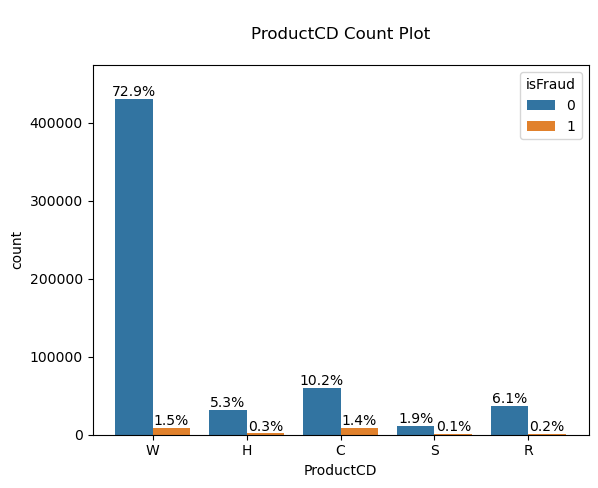

In [14]:
ax = sns.countplot(x='ProductCD', hue='isFraud', data = train_data)

plt.margins(0.05, 0.1)

for p in ax.patches:
    x=p.get_bbox().get_points()[:,0]
    y=p.get_bbox().get_points()[1,1]
    if y>0:
        ax.annotate('{:.1f}%'.format(100.*y/len(train_data)), (x.mean(), y),ha='center', va='bottom')

plt.title('\nProductCD Count Plot\n')
plt.show()

### Analysis
- There is more fraud comparitively for the ProductCode C compare to others.

# M feature Analysis


/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_85765/1629380746.py:31: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


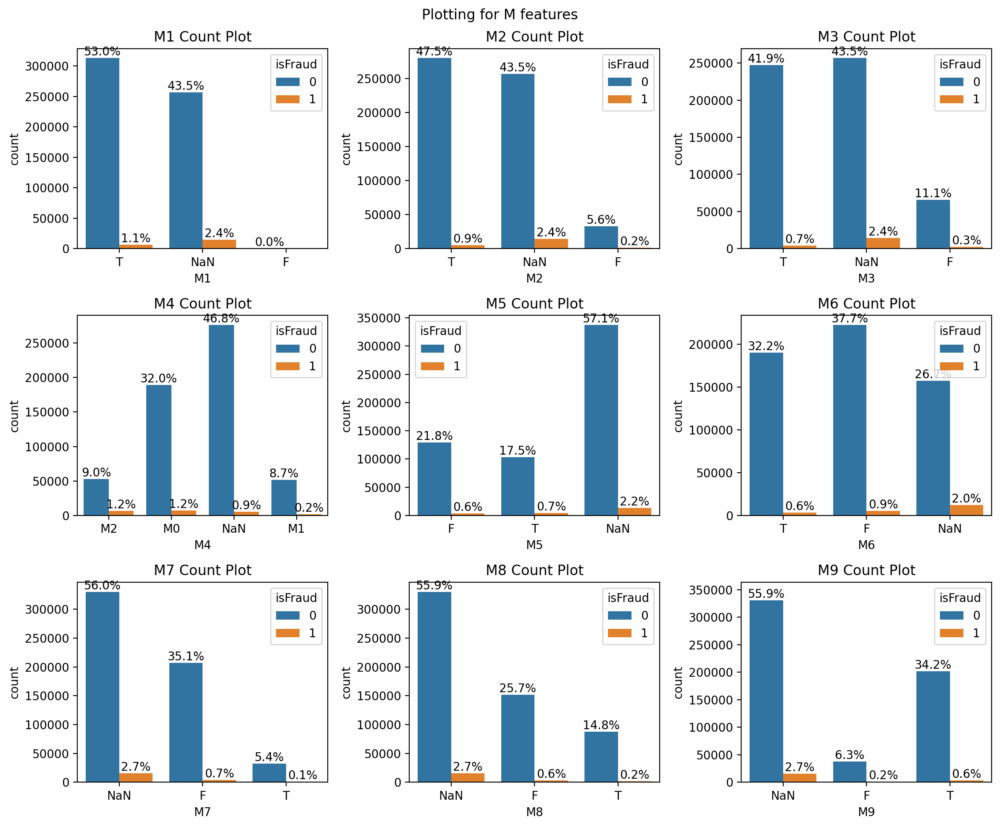

In [15]:
m_features = ["M"+str(i) for i in range(1,10) if "M"+str(i) in train_data.columns]
train_data[m_features] = train_data[m_features].fillna('NaN')
fig, axes = plt.subplots(3, 3, figsize=(12, 10), dpi=200)

fig.tight_layout(pad=6.0)
fig.suptitle('Plotting for M features')
idx = 0

plt.margins(0.05, 0.1)

for i in range(3):
    for j in range(3):

        if(idx==len(m_features)):
            break

        f = m_features[idx]
        idx+=1

        sns.countplot(x=f,hue='isFraud', data=train_data, ax=axes[i,j])

        for p in axes[i,j].patches:
              x=p.get_bbox().get_points()[:,0]
              y=p.get_bbox().get_points()[1,1]
              if y > 0:
                  axes[i,j].annotate('{:.1f}%'.format(100.*y/len(train_data)), (x.mean(), y),
                          ha='center', va='bottom')

        axes[i,j].set_title(f+" Count Plot")

plt.tight_layout()
plt.show()

## Analysis
- These features indicate matching values, such as whether the name on the card matches or not, and are predominantly in the form of "T" or "F".

- Most transactions lack information for these features.

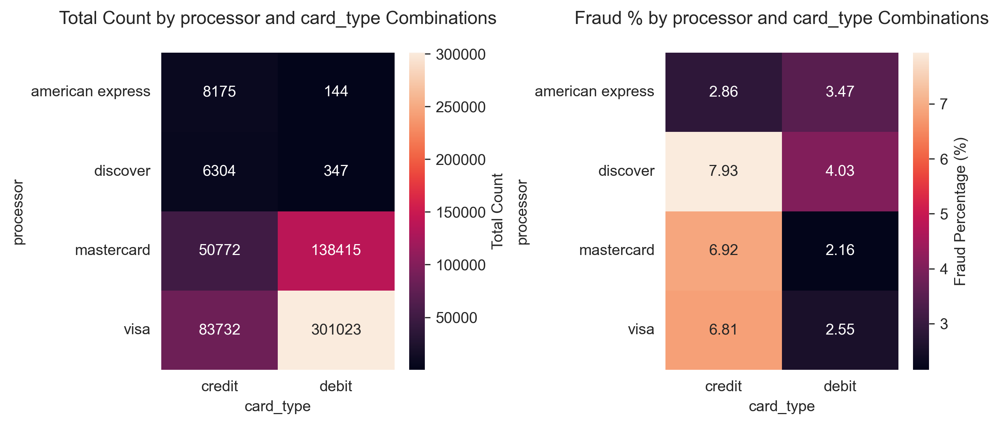

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def get_heatmap(column_names, df=train):
    dims = column_names + ['isFraud']
    
    # Calculate total counts for each combination
    total_counts = df[dims].groupby(column_names).size().reset_index(name='total_count')
    
    # Calculate fraud counts for each combination
    fraud_counts = (
        df[df['isFraud'] == 1][column_names]
        .value_counts()
        .reset_index(name='fraud_count')
    )
    
    # Merge total and fraud counts
    merged_counts = pd.merge(total_counts, fraud_counts, on=column_names, how='left').fillna(0)
    
    # Calculate fraud percentage
    merged_counts['fraud_percentage'] = (
        merged_counts['fraud_count'] / merged_counts['total_count']
    ) * 100
    
    # Plot heatmaps side by side
    fig, axes = plt.subplots(1, 2, figsize=(9, 4), dpi=300)
    
    # First plot: Total Counts
    total_count_matrix = merged_counts.pivot(
        index=column_names[0], 
        columns=column_names[1], 
        values='total_count'
    ).fillna(0)
    
    sns.heatmap(
        total_count_matrix, 
        annot=True, 
        fmt=".0f", 
        cbar_kws={'label': 'Total Count'}, 
        ax=axes[0]
    )
    axes[0].set_title(f"Total Count by {column_names[0]} and {column_names[1]} Combinations\n")
    
    # Second plot: Fraud Percentage
    fraud_matrix = merged_counts.pivot(
        index=column_names[0], 
        columns=column_names[1], 
        values='fraud_percentage'
    ).fillna(0)
    
    sns.heatmap(
        fraud_matrix, 
        annot=True, 
        fmt=".2f", 
        cbar_kws={'label': 'Fraud Percentage (%)'}, 
        ax=axes[1]
    )
    axes[1].set_title(f"Fraud % by {column_names[0]} and {column_names[1]} Combinations\n")
    
    plt.tight_layout()
    plt.show()

# Call the function with your DataFrame
temp_df = train_df.copy()
temp_df['processor'] = temp_df['card4']
temp_df['card_type'] = temp_df['card6']
filtered_df = temp_df[temp_df['card_type'].isin(['credit', 'debit'])]
get_heatmap(['processor', 'card_type'], filtered_df)


              card4   card6  fraud_count
0              visa   debit         7669
1              visa  credit         5704
2        mastercard  credit         3511
3        mastercard   debit         2985
4          discover  credit          500
5  american express  credit          234
6          discover   debit           14
7  american express   debit            5


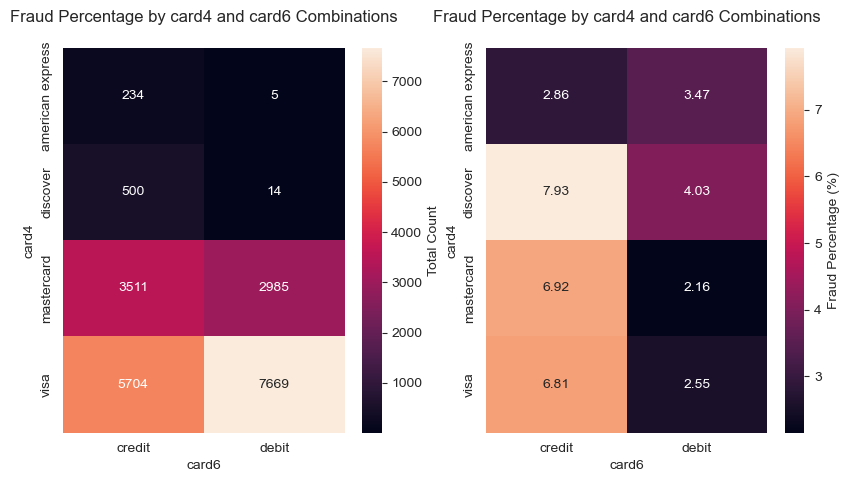

In [19]:
def get_heatmap(column_names, df=train):
    dims = column_names + ['isFraud']
    # Calculate total counts for each P_emaildomain and R_emaildomain combination
    total_counts = df[dims].groupby(column_names).size().reset_index(name='total_count')
    # print(total_counts)

    # Calculate fraud counts for each P_emaildomain and R_emaildomain combination
    fraud_counts = df[df['isFraud'] == 1][column_names].value_counts().reset_index(name='fraud_count')
    
    # Merge total and fraud counts
    merged_counts = pd.merge(total_counts, fraud_counts, on=column_names, how='left').fillna(0)

    # Calculate fraud percentage
    merged_counts['fraud_percentage'] = (merged_counts['fraud_count'] / merged_counts['total_count']) * 100
    
    # Plot heatmaps side by side
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    fraud_count_matrix = merged_counts[merged_counts['fraud_count'] > 0].pivot(index=column_names[0], columns=column_names[1], values='fraud_count').fillna(0)
    sns.heatmap(fraud_count_matrix, annot=True, fmt=".0f", cbar_kws={'label': 'Total Count'}, ax=axes[0])
    axes[0].set_title(f"Fraud Percentage by {column_names[0]} and {column_names[1]} Combinations\n")
    
    fraud_matrix = merged_counts[merged_counts['fraud_percentage'] > 0].pivot(index=column_names[0], columns=column_names[1], values='fraud_percentage').fillna(0)
    sns.heatmap(fraud_matrix, annot=True, fmt=".2f", cbar_kws={'label': 'Fraud Percentage (%)'}, ax=axes[1])
    axes[1].set_title(f"Fraud Percentage by {column_names[0]} and {column_names[1]} Combinations\n")
    
    plt.show()
    
    

get_heatmap(['card4', 'card6'], train_transaction_df)


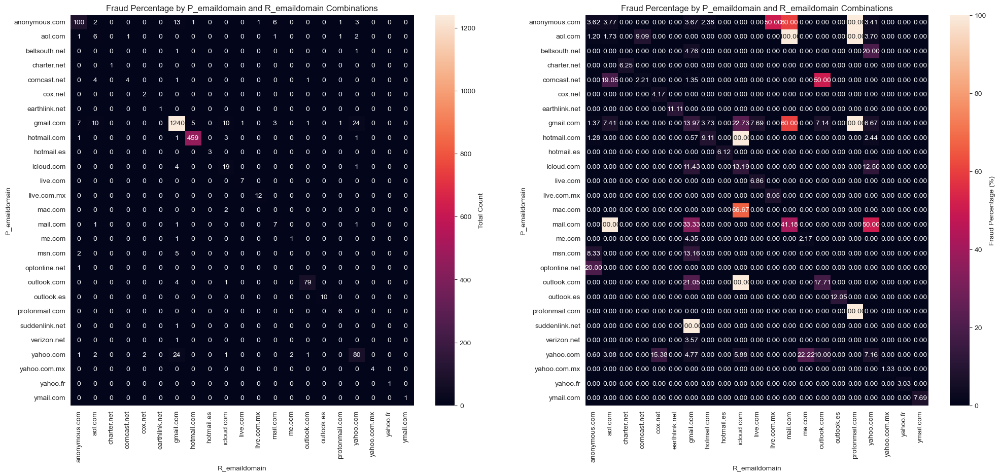

In [10]:
get_heatmap(['P_emaildomain', 'R_emaildomain'])


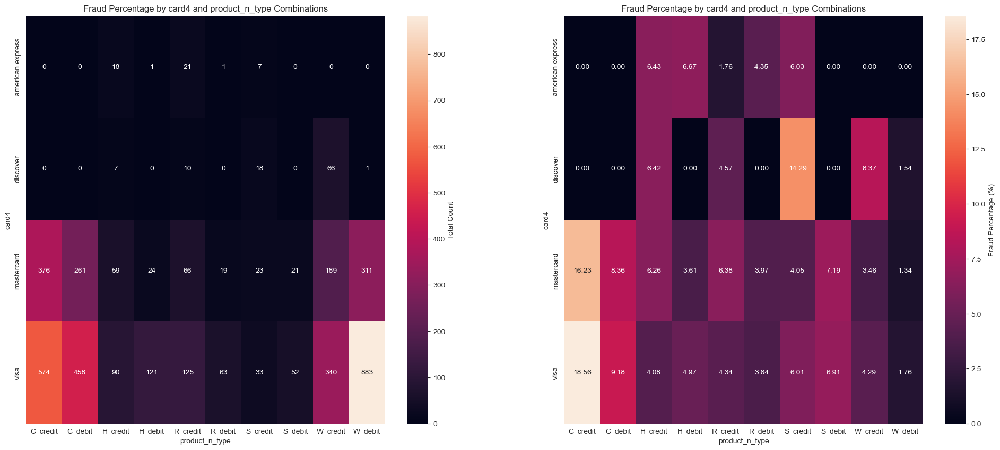

In [7]:
temp = train.copy()
temp['product_n_type'] = temp['ProductCD'] + "_" + temp['card6']

get_heatmap(['card4', 'product_n_type'], temp)


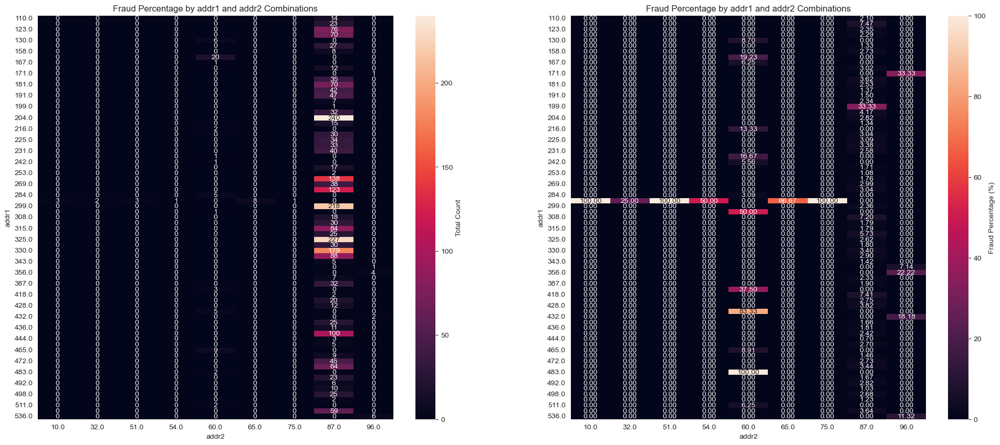

In [8]:
get_heatmap(['addr1', 'addr2'], temp)


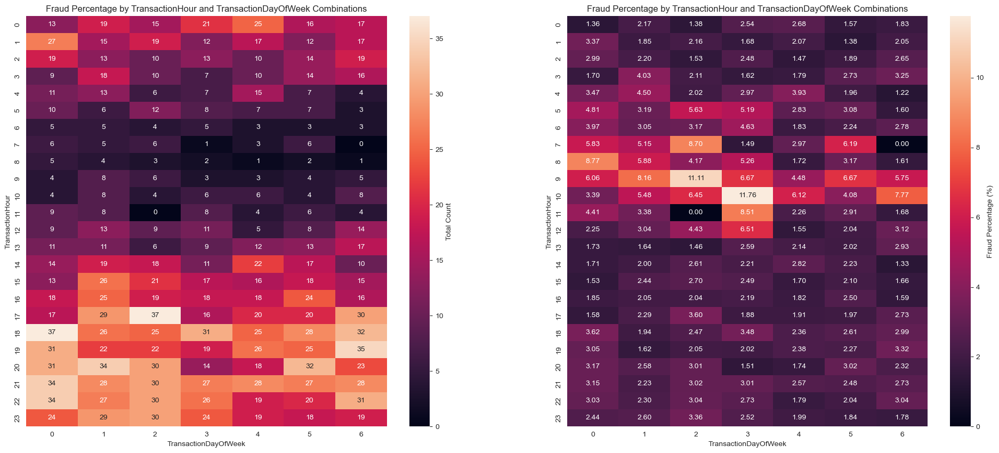

In [9]:
train['TransactionHour'] = (train['TransactionDT'] // (60 * 60)) % 24
train['TransactionDayOfWeek'] = (train['TransactionDT'] // (60 * 60 * 24)) % 7

get_heatmap(['TransactionHour', 'TransactionDayOfWeek'], train[train['addr2'] == 87])


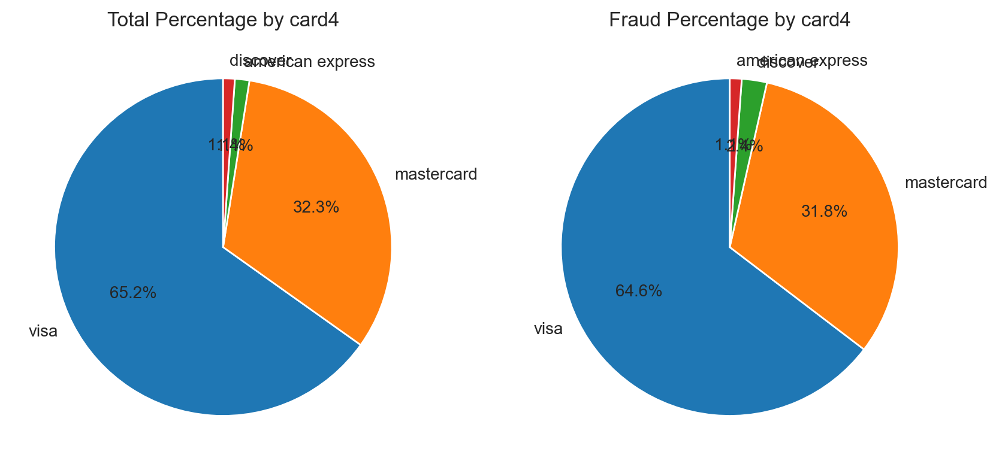

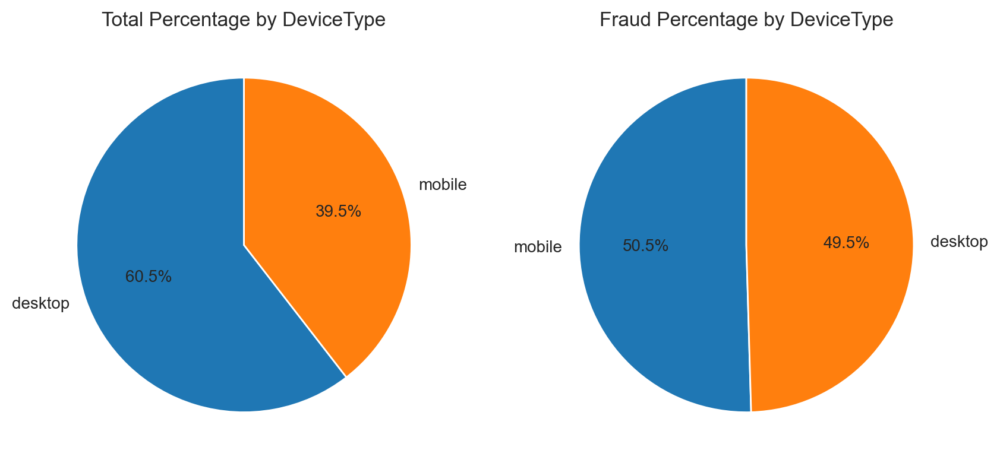

In [49]:
# create pie chart of a column side by side with fraud yes and total
def get_pie_chart(column_name, df=train):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5), dpi=200)
    
    fraud_counts = df[df['isFraud'] == 1][column_name].value_counts()
    total_counts = df[column_name].value_counts()
    
    axes[0].pie(total_counts, labels=total_counts.index, autopct='%1.1f%%', startangle=90)
    axes[0].set_title(f"Total Percentage by {column_name}")
    
    axes[1].pie(fraud_counts, labels=fraud_counts.index, autopct='%1.1f%%', startangle=90)
    axes[1].set_title(f"Fraud Percentage by {column_name}")
    
    plt.show()
   
get_pie_chart('card4', train)
get_pie_chart('DeviceType', train_df)
 


/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_26110/2601562296.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fraud_transactions['TransactionDate'] = pd.to_datetime((fraud_transactions['TransactionDT'] // (60 * 60 * 24)), unit='D')


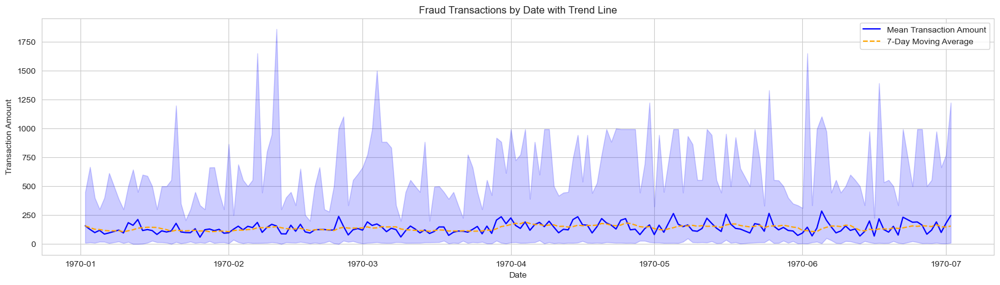

In [11]:
# plot fraud transactions by date average amount add lower and upper limit also with lines add add the non fraud transactions also
def plot_fraud_transactions_by_date(df, fraud_filter = 1, upper_limit=2000):
    fig, ax = plt.subplots(figsize=(20, 5))
    
    fraud_transactions = df[(df['isFraud']) == fraud_filter]
    fraud_transactions['TransactionDate'] = pd.to_datetime((fraud_transactions['TransactionDT'] // (60 * 60 * 24)), unit='D')
    
    # Group by date and calculate mean, std, min, max for TransactionAmt
    fraud_transactions = fraud_transactions.groupby('TransactionDate').agg({'TransactionAmt': ['mean', 'std', 'min', 'max']}).reset_index()
    fraud_transactions = fraud_transactions[fraud_transactions['TransactionAmt']['max'] < upper_limit]

    # Plot mean transaction amount
    ax.plot(fraud_transactions['TransactionDate'], fraud_transactions['TransactionAmt']['mean'], label='Mean Transaction Amount', color='blue')
    
    # Calculate and plot a 7-day rolling mean as a trend line
    fraud_transactions['Trend'] = fraud_transactions['TransactionAmt']['mean'].rolling(window=7, min_periods=1).mean()
    ax.plot(fraud_transactions['TransactionDate'], fraud_transactions['Trend'], label='7-Day Moving Average', color='orange', linestyle='--')
    
    # Fill between min and max transaction amount (unchanged)
    ax.fill_between(fraud_transactions['TransactionDate'], 
                    fraud_transactions['TransactionAmt']['min'], 
                    fraud_transactions['TransactionAmt']['max'], 
                    color='blue', alpha=0.2)
    
    # Set labels and title
    ax.set_title("Fraud Transactions by Date with Trend Line")
    ax.set_xlabel("Date")
    ax.set_ylabel("Transaction Amount")
    ax.legend()
    
    plt.show()


plot_fraud_transactions_by_date(train, fraud_filter=1)

- given the plot, we don't see any trend line, but we can see that the transaction amount is between 0 and 2000
- we can see there is no seasonality in the data and its evenly distributed for the transaction amount and time
- there are occasional spikes in the transaction amount, but they are not significant

In [13]:
print(train[[c for c in train.columns if 'card' in c]].head())
train[[c for c in train.columns if 'card' in c]].nunique()


        card1  card2  card3       card4  card5  card6
470624   7826  481.0  150.0  mastercard  224.0  debit
565820  12544  321.0  150.0        visa  226.0  debit
284083   9400  111.0  150.0  mastercard  224.0  debit
239689  15885  545.0  185.0        visa  138.0  debit
281855  15497  490.0  150.0        visa  226.0  debit


card1    8161
card2     500
card3      89
card4       4
card5      87
card6       4
dtype: int64

## Scatter Plot with KDE to get understanding of the data and target variable

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_pairplot(column_names, df=train):
    # Create a pairplot with KDE, using hue for isFraud
    plot_data = df[column_names + ['isFraud']].sort_values(by='isFraud', ascending=True)  # Include 'isFraud' in the data
    sns.pairplot(plot_data, hue='isFraud', kind='scatter', diag_kind='kde', palette={0: 'lightgrey', 1: 'red'})

    # Show the plot
    plt.suptitle(f"Scatter Plot with KDE for {column_names}", y=1.02)  # Adjust title position
    plt.tight_layout()
    plt.show()

/Users/anjali/anaconda3/envs/python310/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_20966/3341347169.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


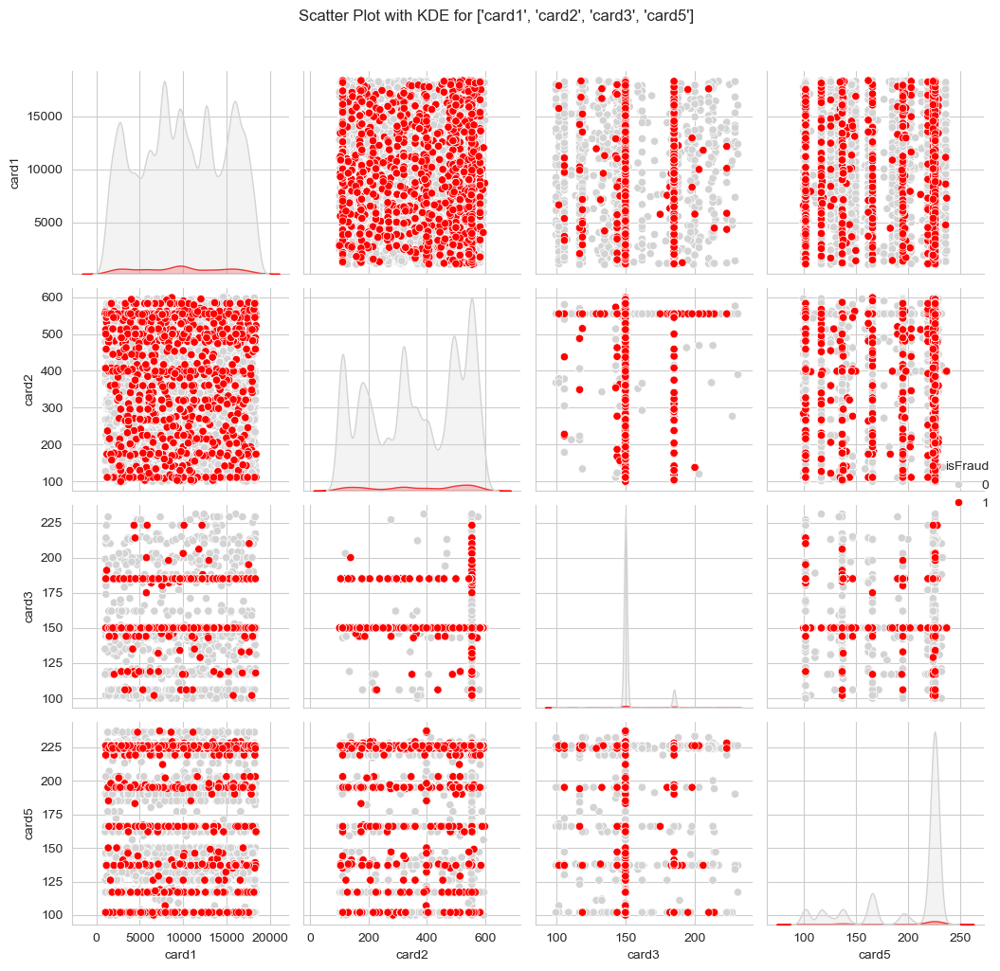

In [14]:

plot_pairplot(['card1', 'card2', 'card3', 'card5'])



/Users/anjali/anaconda3/envs/python310/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_20966/3341347169.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


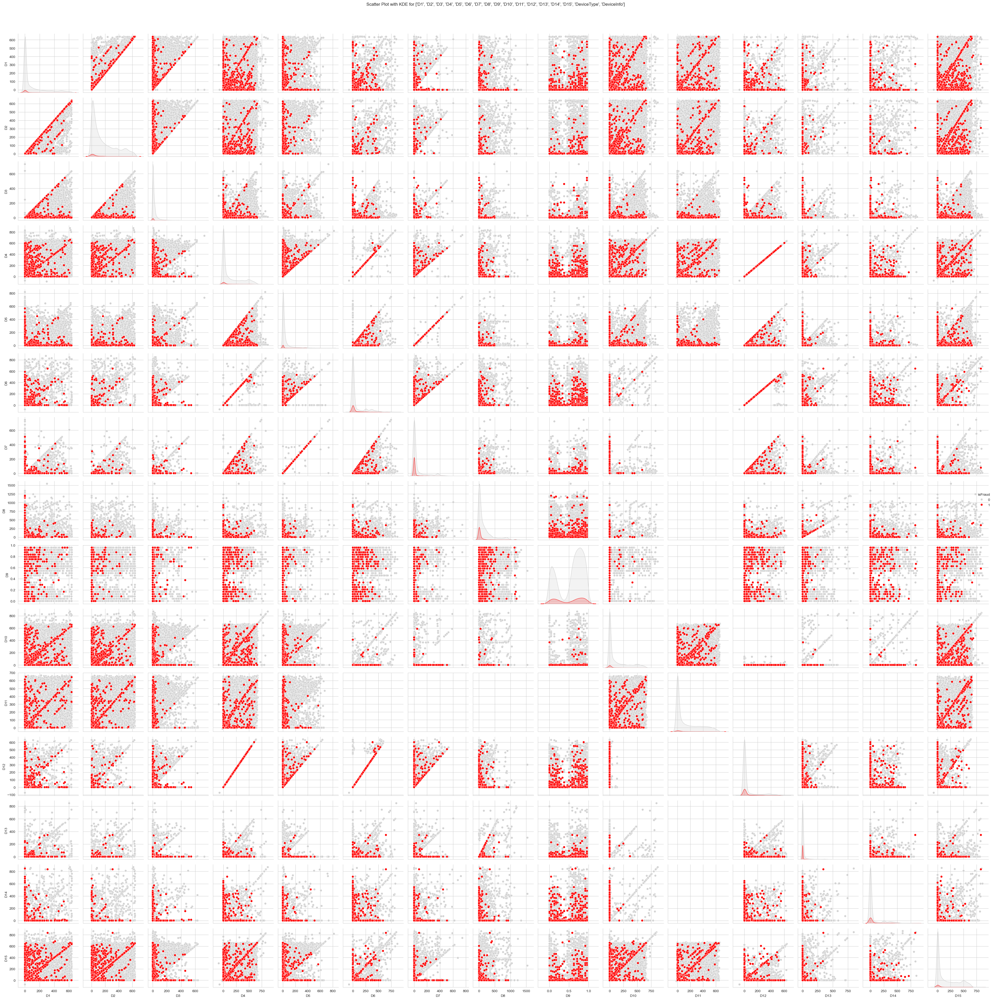

In [15]:
plot_pairplot([c for c in train.columns if c.startswith('D')])


/Users/anjali/anaconda3/envs/python310/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_20966/3341347169.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


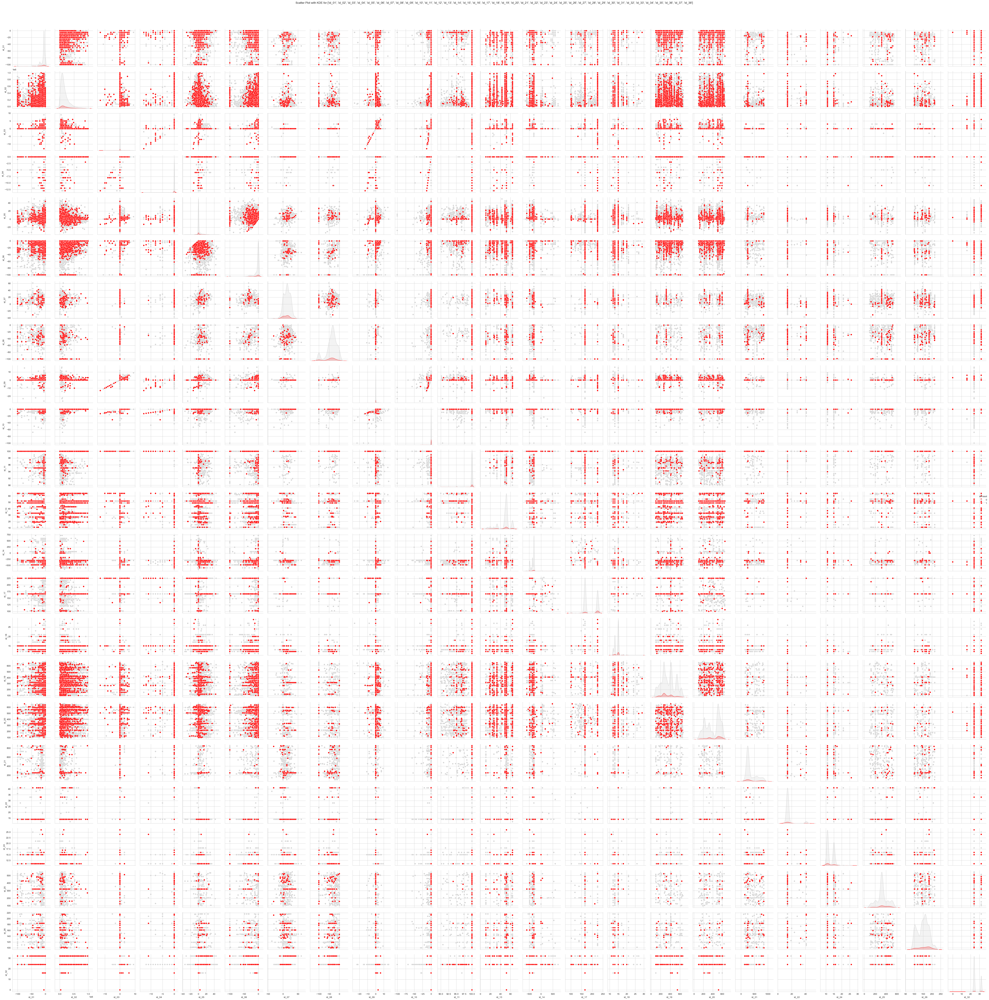

In [23]:
plot_pairplot([c for c in train.columns if c.startswith('id')])

/Users/anjali/anaconda3/envs/python310/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_26110/1025819689.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


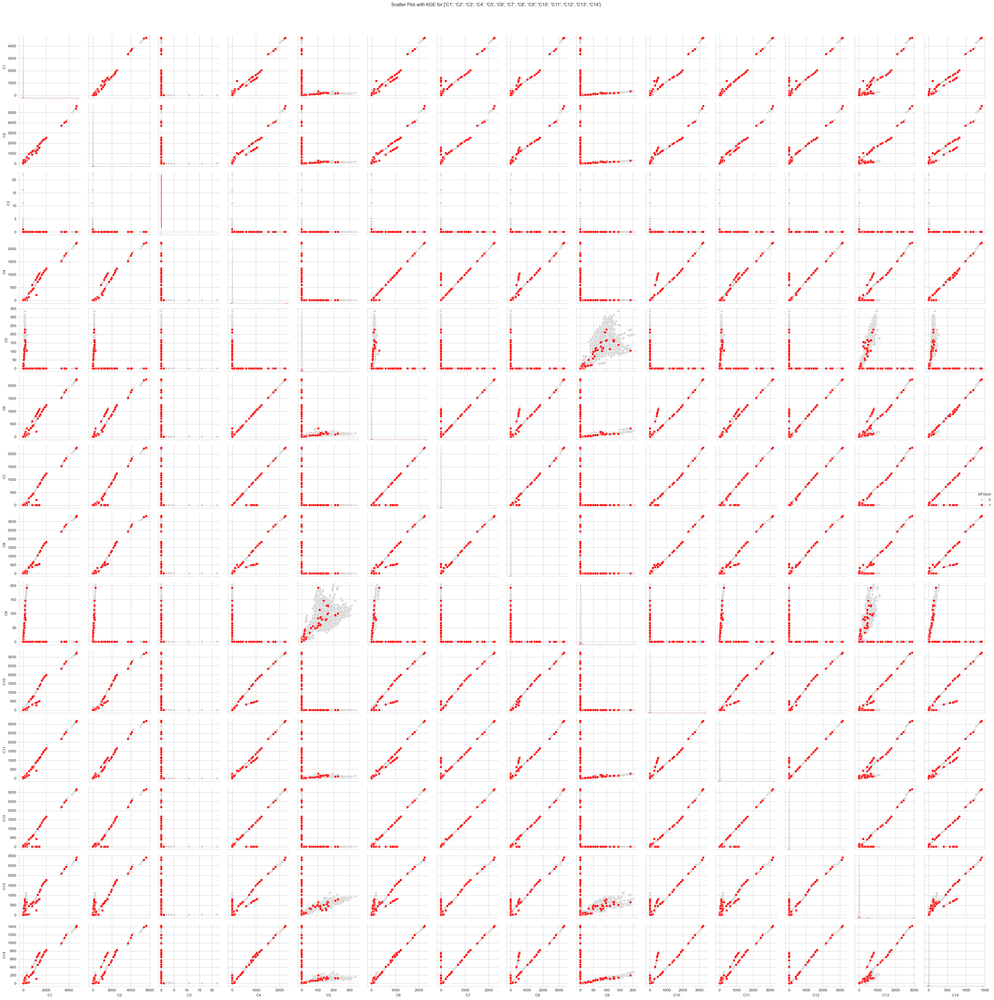

In [14]:
plot_pairplot([c for c in train.columns if c.startswith('C')])

In [15]:
train.head()


,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionHour,TransactionDayOfWeek
470624,3457624,0,12153579,724.000,W,7826,481.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,0
565820,3552820,0,15005886,108.500,W,12544,321.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,5
284083,3271083,0,6970178,47.950,W,9400,111.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,3
239689,3226689,0,5673658,100.599,C,15885,545.0,185.0,visa,138.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,2
281855,3268855,0,6886780,107.950,W,15497,490.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16,2


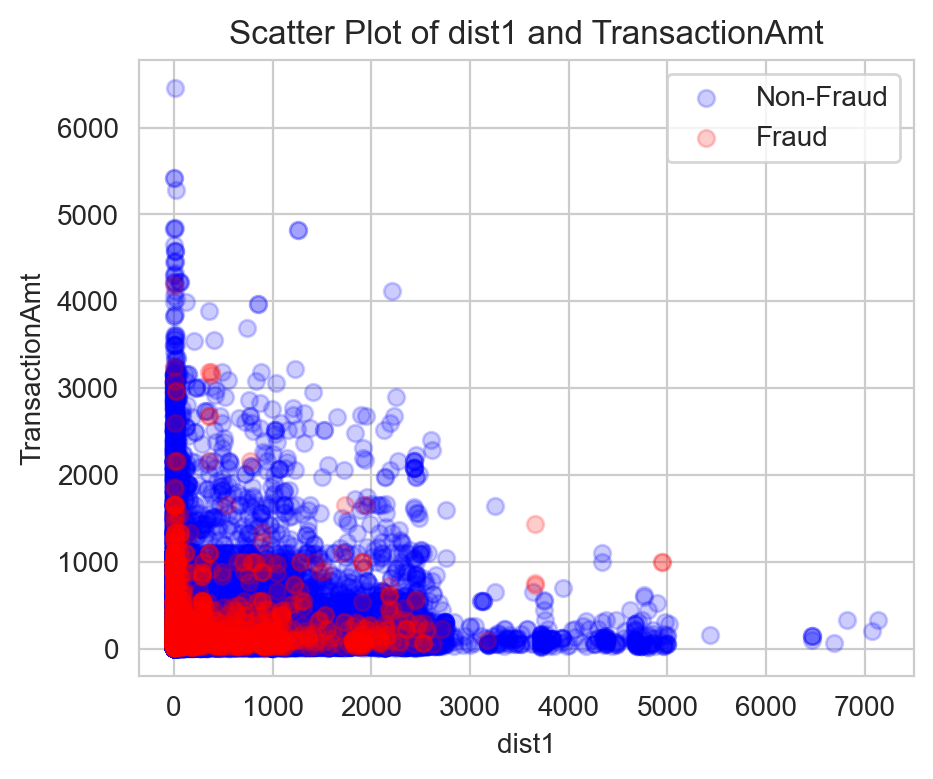

In [66]:
import numpy as np
import matplotlib.pyplot as plt

def plot_scatter(column_names, df=train):
    fig, ax = plt.subplots(figsize=(5, 4), dpi=200)

    df = df[df['TransactionAmt'] <= 10000 ]
    df = df[df['dist1'] <= 8000 ] 
    # Plot non-fraud transactions
    ax.scatter(df[df['isFraud'] == 0][column_names[0]], df[df['isFraud'] == 0][column_names[1]], color='blue', label='Non-Fraud', alpha=0.2)

    # Plot fraud transactions
    ax.scatter(df[df['isFraud'] == 1][column_names[0]], df[df['isFraud'] == 1][column_names[1]], color='red', label='Fraud', alpha=0.2)
    
    # Set labels and title
    ax.set_xlabel(column_names[0])
    ax.set_ylabel(column_names[1])
    ax.set_title(f"Scatter Plot of {column_names[0]} and {column_names[1]}")
    ax.legend()

    plt.show()

plot_scatter(['dist1', 'TransactionAmt'], train_df)

# # create a column where dist1 is null take it from dist2
# temp = train_df.copy()
# temp['distance'] = temp['dist1'].fillna(temp['dist2'])
# plot_scatter(['distance', 'TransactionAmt'], temp)


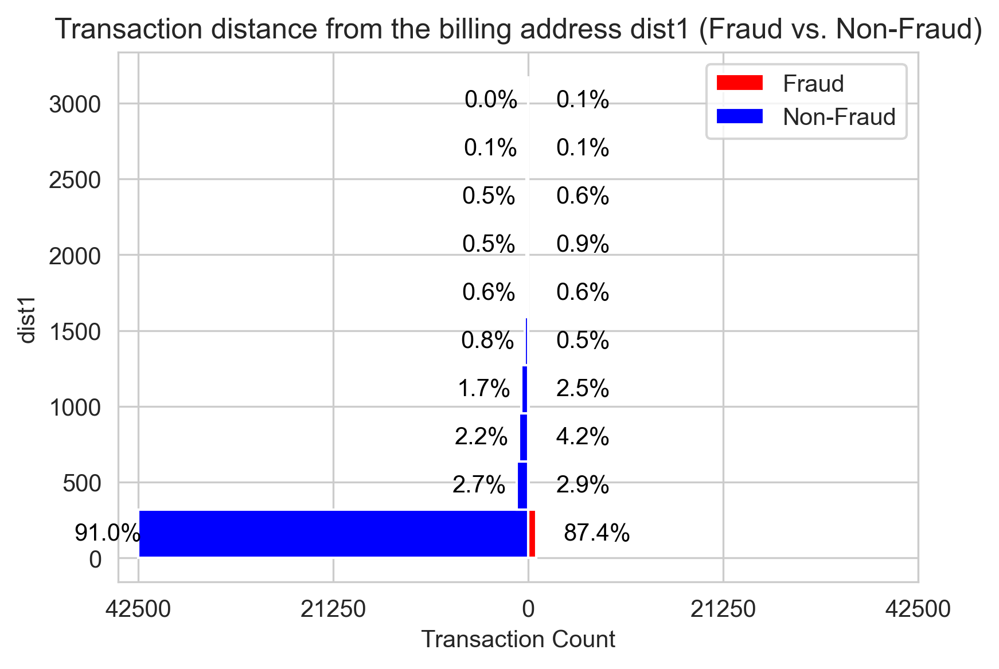

In [44]:
import matplotlib.pyplot as plt
import numpy as np

def plot_butterfly_histogram(column_name, bins=10, df=train):
    fig, ax = plt.subplots(figsize=(6, 4), dpi=300)

    # Drop NaNs and separate data into fraud and non-fraud
    df = df.dropna(subset=[column_name])
    fraud_data = df[df['isFraud'] == 1][column_name]
    non_fraud_data = df[df['isFraud'] == 0][column_name]

    # Check if there is data in both fraud and non-fraud subsets
    if fraud_data.empty or non_fraud_data.empty:
        print(f"No data available for plotting in column '{column_name}' for one or both categories.")
        return

    # Generate histogram data for each side
    fraud_counts, bin_edges = np.histogram(fraud_data, bins=bins)
    non_fraud_counts, _ = np.histogram(non_fraud_data, bins=bin_edges)  # Use same bins for comparison
    total_fraud = fraud_counts.sum()
    total_non_fraud = non_fraud_counts.sum()

    # Calculate bin centers for plotting
    bin_centers = (bin_edges[1:] + bin_edges[:-1]) / 2

    # Plot bars: Fraud data on the right, Non-Fraud on the left
    ax.barh(bin_centers, fraud_counts, color='red', label='Fraud', height=bin_edges[1] - bin_edges[0])
    ax.barh(bin_centers, -non_fraud_counts, color='blue', label='Non-Fraud', height=bin_edges[1] - bin_edges[0])

    # Add percentage labels
    for count, center in zip(fraud_counts, bin_centers):
        percentage = (count / total_fraud) * 100 if total_fraud > 0 else 0
        ax.text(count + 3000, center, f'{percentage:.1f}%', va='center', color='black')

    for count, center in zip(non_fraud_counts, bin_centers):
        percentage = (count / total_non_fraud) * 100 if total_non_fraud > 0 else 0
        ax.text(-count - 7000, center, f'{percentage:.1f}%', va='center', color='black')

    # Labeling
    ax.set_xlabel("Transaction Count")
    ax.set_ylabel(column_name)
    ax.set_title(f"Transaction distance from the billing address {column_name} (Fraud vs. Non-Fraud)")

    # Set x-ticks to display positive values for both sides
    max_count = max(fraud_counts.max(), non_fraud_counts.max())
    ax.set_xticks([-max_count, -max_count // 2, 0, max_count // 2, max_count])
    ax.set_xticklabels([str(abs(x)) for x in ax.get_xticks()])

    # Add a legend
    ax.legend(loc='upper right')

    plt.show()

# Example usage
plot_butterfly_histogram('dist1')


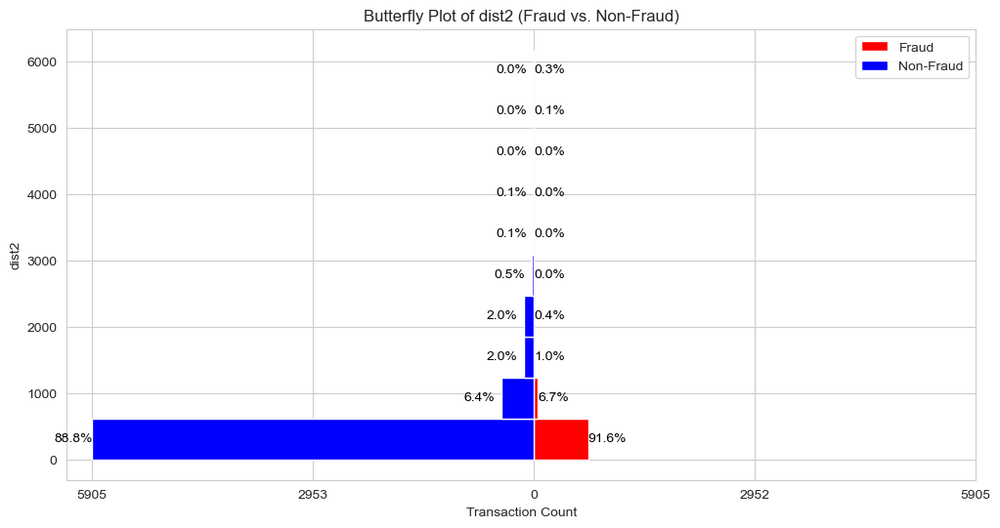

In [53]:
plot_butterfly_histogram('dist2')


No data available for plotting in column 'dist2' for one or both categories.


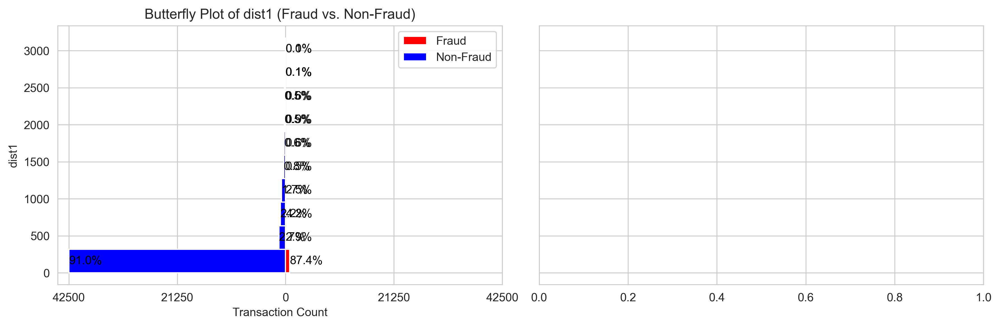

/Users/anjali/anaconda3/envs/python310/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/var/folders/l2/k_0hhyfd76b__51kf1m_vk_c0000gn/T/ipykernel_26110/1025819689.py:11: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


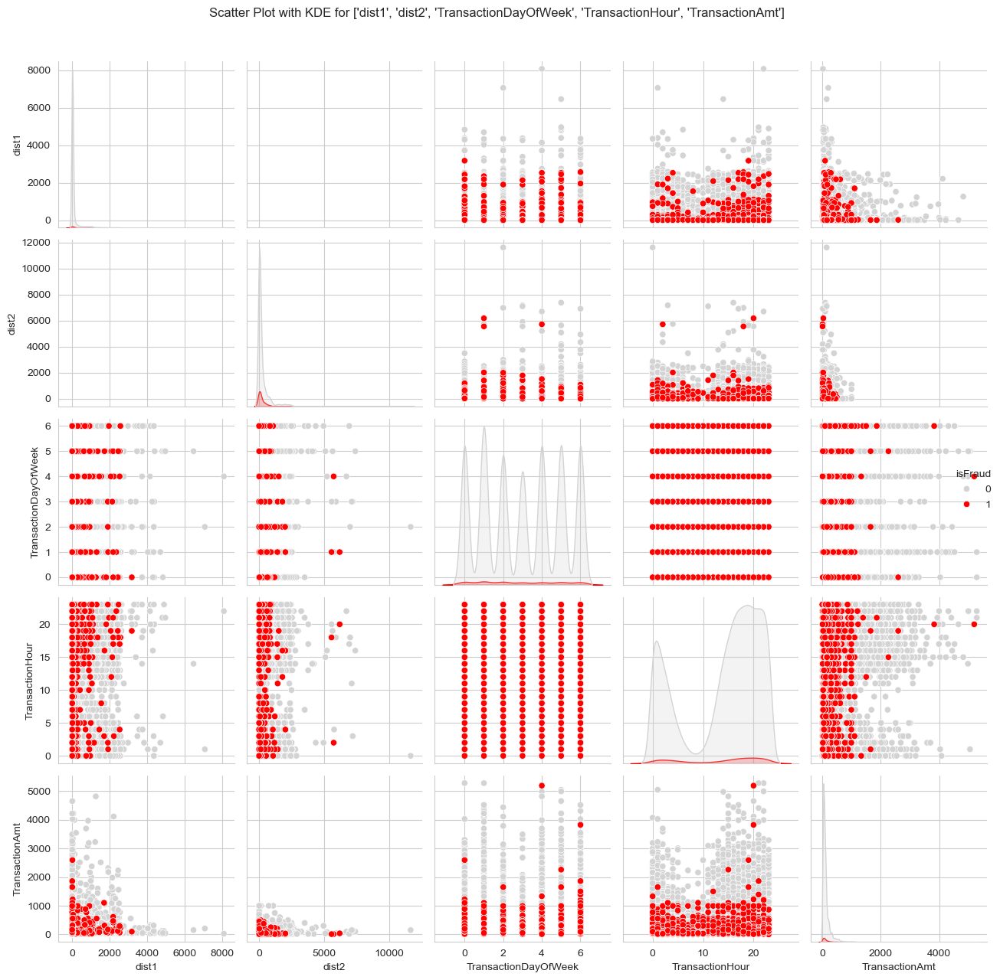

In [65]:
plot_pairplot(['dist1', 'dist2', 'TransactionDayOfWeek', 'TransactionHour', 'TransactionAmt', ], train[train['TransactionAmt'] < 30000])


- we can see that the transaction amount is between 0 and 30000
- we can see that the transaction amount is evenly distributed for the transaction amount and time
- there are occasional spikes in the transaction amount, but they are not significant

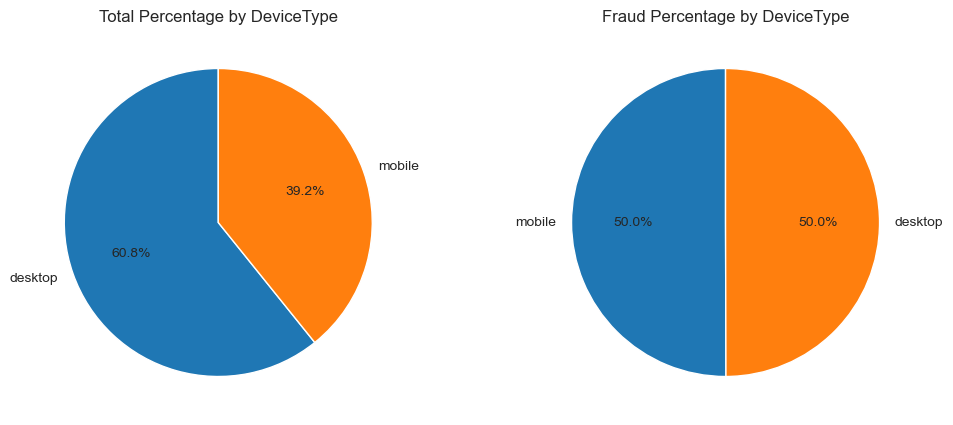

In [87]:
get_pie_chart('DeviceType')


In [36]:
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots

def get_sunburst_plot(df):
    # Get path columns (all columns except 'isFraud')
    path_columns = df.columns[:-1]  # Exclude the last column (isFraud)
    print(f"{path_columns = }")

    # Filter data for fraud and non-fraud
    fraud_data = df[df['isFraud'] == 1]
    non_fraud_data = df[df['isFraud'] == 0]

    # Create a new DataFrame with counts for Non-Fraud transactions
    non_fraud_counts = non_fraud_data.groupby(list(path_columns)).size().reset_index(name='count')

    # Create a new DataFrame with counts for Fraud transactions
    fraud_counts = fraud_data.groupby(list(path_columns)).size().reset_index(name='count')

    # Define custom colors for each category in the sunburst
    non_fraud_colors = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA']  # Colors for Non-Fraud segments
    fraud_colors = ['#FF6692', '#FECB52', '#19D3F3', '#B2B2B2']  # Colors for Fraud segments

    # Create subplots with increased size
    fig = make_subplots(rows=1, cols=2,
                        subplot_titles=("Non-Fraud Transactions", "Fraud Transactions"),
                        specs=[[{'type': 'sunburst'}, {'type': 'sunburst'}]],
                        horizontal_spacing=0.1)

    # Create a sunburst plot for Non-Fraud transactions
    non_fraud_sunburst = px.sunburst(non_fraud_counts,
                                      path=list(path_columns),
                                      values='count')
    non_fraud_sunburst.update_traces(marker=dict(colors=non_fraud_colors))  # Set the colors

    # Create a sunburst plot for Fraud transactions
    fraud_sunburst = px.sunburst(fraud_counts,
                                  path=list(path_columns),
                                  values='count')
    fraud_sunburst.update_traces(marker=dict(colors=fraud_colors))  # Set the colors

    # Add the traces to the subplot
    fig.add_trace(non_fraud_sunburst.data[0], row=1, col=1)
    fig.add_trace(fraud_sunburst.data[0], row=1, col=2)

    # Update layout with increased size
    fig.update_layout(title_text="Sunburst Plots of Transactions by Fraud Status",
                      title_x=0.5,
                      height=800,  # Increase the height
                      width=1200)  # Increase the width

    # Show the plots
    fig.show()

# Example usage with the train DataFrame
get_sunburst_plot(filtered_df[['DeviceType', 'processor', 'card_type', 'ProductCD', 'isFraud']])


path_columns = Index(['DeviceType', 'processor', 'card_type', 'ProductCD'], dtype='object')


- we can see that the fraud transactions are more in the mobile device type
- visa credit and debit have similar fraud transactions, but for master card its more in credit
- for visa the product code "C" have highest fraud transactions
-

## Merge Emails

In [112]:
import pandas as pd

def categorize_email_domains(df, column_name):

    # Check if the specified column exists in the DataFrame
    if column_name not in df.columns:
        raise ValueError(f"Column '{column_name}' does not exist in the DataFrame.")

    # Categorize Google domains
    df.loc[df[column_name].isin(['gmail.com', 'gmail']), column_name] = 'google'

    # Categorize Yahoo domains
    df.loc[df[column_name].isin(['yahoo.com', 'yahoo.com.mx', 'yahoo.co.uk',
                                  'yahoo.co.jp', 'yahoo.de', 'yahoo.fr',
                                  'yahoo.es']), column_name] = 'yahoo'

    # Categorize Microsoft domains
    df.loc[df[column_name].isin(['hotmail.com', 'outlook.com', 'msn.com', 'live.com.mx',
                                  'hotmail.es', 'hotmail.co.uk', 'hotmail.de',
                                  'outlook.es', 'live.com', 'live.fr',
                                  'hotmail.fr']), column_name] = 'microsoft'

    # Categorize domains appearing less than or equal to 500 times as 'Others'
    df.loc[df[column_name].isin(df[column_name].value_counts()[df[column_name].value_counts() <= 10000].index), column_name] = "Others"

    # Fill NaN values with "NoInf"
    df[column_name].fillna("NoInf", inplace=True)

    return df

# Example usage
# Assuming df_trans is your DataFrame
df_trans = categorize_email_domains(train.copy(), 'P_emaildomain')
df_trans = categorize_email_domains(df_trans, 'R_emaildomain')

get_sunburst_plot(df_trans[['P_emaildomain', 'R_emaildomain', 'isFraud']])


path_columns = Index(['P_emaildomain', 'R_emaildomain'], dtype='object')


In [52]:
temp_df = filtered_df.copy()
temp_df['status'] = temp_df['isFraud']
get_sunburst_plot(temp_df[['DeviceType', 'status', 'isFraud']])


path_columns = Index(['DeviceType', 'status'], dtype='object')


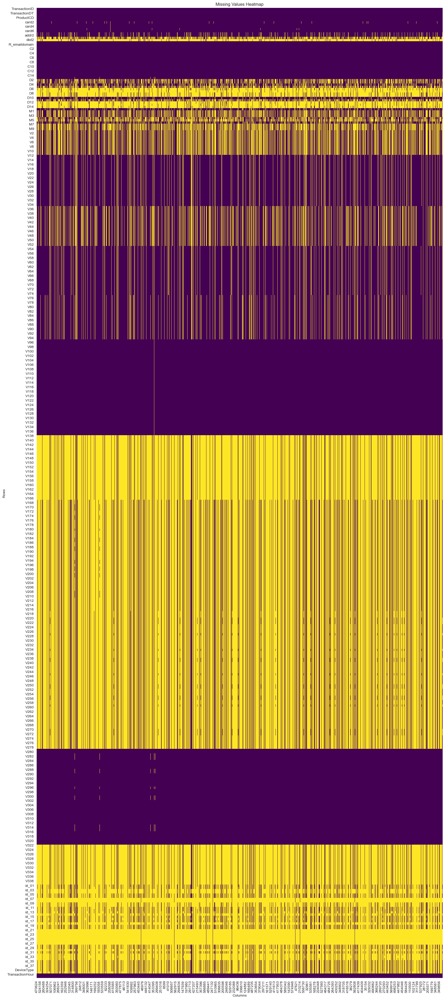

In [117]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_missing_values_heatmap(df):
    plt.figure(figsize=(20, 48))
    sns.heatmap(df.isnull().T, cbar=False, cmap='viridis')
    plt.title("Missing Values Heatmap")
    plt.xlabel("Columns")
    plt.ylabel("Rows")
    plt.show()

plot_missing_values_heatmap(train)

In [53]:
import plotly.express as px
import pandas as pd

def create_sunburst_chart(df, levels, color_column='fraud_status'):
    """
    Creates a sunburst chart based on the specified hierarchical levels with fraud and non-fraud counts.

    Parameters:
    - df (pd.DataFrame): The input DataFrame containing hierarchical data.
    - levels (list of str): List of columns in hierarchical order for sunburst layers (from innermost to outermost).
    - color_column (str): Name of the column to color segments by ('fraud_status' in this case).

    Returns:
    - A Plotly sunburst chart.
    """
    
    # Compute fraud and non-fraud counts based on the isFraud column
    fraud_counts = (
        df
        .assign(fraud_status=df['isFraud'].map({1: 'Fraud', 0: 'Non-Fraud'}))  # Map isFraud to labels
        .groupby(levels + [color_column])  # Group by specified hierarchy and fraud status
        .size()  # Get counts
        .reset_index(name='counts')  # Reset index to make 'counts' a column
    )

    # Create the sunburst chart
    fig = px.sunburst(
        fraud_counts,
        path=levels + [color_column],  # Define hierarchy for sunburst layers
        values='counts',               # Values used for segment sizes
        color=color_column,            # Color by the fraud status
        color_discrete_map={'Fraud': 'red', 'Non-Fraud': 'blue'}  # Customize color for fraud and non-fraud
    )

    # Customize layout
    fig.update_layout(
        title="Sunburst Chart of Fraud and Non-Fraud Transactions",
        margin=dict(t=40, l=0, r=0, b=0)
    )

    # Show the chart
    fig.show()


# Call the function with your DataFrame and desired settings
create_sunburst_chart(train_df, levels=['DeviceType', 'isFraud'])
